<a href="https://colab.research.google.com/github/FawwazMayda/BangkitPlantPathology/blob/master/BangkitPrep.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [0]:
!pip uninstall -y kaggle
!pip install --upgrade pip
!pip install kaggle==1.5.6
!kaggle -v

Uninstalling kaggle-1.5.6:
  Successfully uninstalled kaggle-1.5.6
     |████████████████████████████████| 1.4MB 6.2MB/s 
  Found existing installation: pip 19.3.1
    Uninstalling pip-19.3.1:
      Successfully uninstalled pip-19.3.1
     |████████████████████████████████| 58 kB 3.1 MB/s 
  Created wheel for kaggle: filename=kaggle-1.5.6-py3-none-any.whl size=72859 sha256=e6382c21aa39206f4c65ad72e8e832a5054e33eba2b32dd32f8042b6e9dcb3db
  Stored in directory: /root/.cache/pip/wheels/01/3e/ff/77407ebac3ef71a79b9166a8382aecf88415a0bcbe3c095a01
Successfully built kaggle
Traceback (most recent call last):
  File "/usr/local/bin/kaggle", line 5, in <module>
    from kaggle.cli import main
  File "/usr/local/lib/python3.6/dist-packages/kaggle/__init__.py", line 23, in <module>
    api.authenticate()
  File "/usr/local/lib/python3.6/dist-packages/kaggle/api/kaggle_api_extended.py", line 149, in authenticate
    self.config_file, self.config_dir))
OSError: Could not find kaggle.json. Make sure

In [0]:
import os
os.environ['KAGGLE_USERNAME']="medias"
os.environ['KAGGLE_KEY']="55874f8ff009725a7cb39cd5832bf1df"

In [0]:
!kaggle competitions download -c plant-pathology-2020-fgvc7
!unzip plant-pathology-2020-fgvc7.zip

 97% 755M/779M [00:14<00:00, 58.0MB/s]
100% 779M/779M [00:14<00:00, 55.5MB/s]
Archive:  plant-pathology-2020-fgvc7.zip
  inflating: images/Test_0.jpg       
  inflating: images/Test_1.jpg       
  inflating: images/Test_10.jpg      
  inflating: images/Test_100.jpg     
  inflating: images/Test_1000.jpg    
  inflating: images/Test_1001.jpg    
  inflating: images/Test_1002.jpg    
  inflating: images/Test_1003.jpg    
  inflating: images/Test_1004.jpg    
  inflating: images/Test_1005.jpg    
  inflating: images/Test_1006.jpg    
  inflating: images/Test_1007.jpg    
  inflating: images/Test_1008.jpg    
  inflating: images/Test_1009.jpg    
  inflating: images/Test_101.jpg     
  inflating: images/Test_1010.jpg    
  inflating: images/Test_1011.jpg    
  inflating: images/Test_1012.jpg    
  inflating: images/Test_1013.jpg    
  inflating: images/Test_1014.jpg    
  inflating: images/Test_1015.jpg    
  inflating: images/Test_1016.jpg    
  inflating: images/Test_1017.jpg    
  infla

In [0]:
import numpy as np
import cv2
from tqdm import tqdm_notebook as tqdm
import pandas as pd
import tensorflow as tf 
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D,Flatten,Dense,BatchNormalization,Dropout,GlobalAveragePooling2D,MaxPooling2D
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.callbacks import ReduceLROnPlateau,ModelCheckpoint,EarlyStopping

In [0]:
train = pd.read_csv("train.csv")
test = pd.read_csv("test.csv")
sub = pd.read_csv("sample_submission.csv")

In [0]:
train.sample(15)

,image_id,healthy,multiple_diseases,rust,scab
1755,Train_1755,0,0,1,0
1767,Train_1767,0,0,0,1
413,Train_413,0,0,1,0
1761,Train_1761,0,0,0,1
1274,Train_1274,0,0,0,1
1145,Train_1145,0,0,1,0
495,Train_495,0,0,1,0
1012,Train_1012,1,0,0,0
81,Train_81,0,0,1,0
1001,Train_1001,1,0,0,0


In [0]:
test.sample(15)

,image_id
329,Test_329
1002,Test_1002
1070,Test_1070
1182,Test_1182
1750,Test_1750
410,Test_410
1727,Test_1727
975,Test_975
804,Test_804
709,Test_709


In [0]:
!mkdir conv

In [0]:
!mkdir blurred

# Visualize

In [0]:
def visualizeSample(cond_class=[0,0,0,0],num=15):
    
    cond_0 = "healthy == {}".format(cond_class[0])
    cond_1 = "multiple_diseases == {}".format(cond_class[1])
    cond_2 = "rust == {}".format(cond_class[2])
    cond_3 = "scab == {}".format(cond_class[3])
    
    data = train.loc[:500]
    for c in [cond_0,cond_1,cond_2,cond_3]:
        data = data.query(c)
        
    img = data.loc[list(data.index)]
    img.reset_index(inplace=True)
    cols,rows = 3, max([3, num//3])
    fig,ax = plt.subplots(nrows=rows,ncols=cols,figsize=(20,15))
    
    for r in range(rows):
        for c in range(cols):
            strPath = 'images/' + str(img.loc[3*r+c,'image_id']) + '.jpg'
            #print(strPath)
            ax[r,c].imshow(plt.imread(strPath))
    plt.show()

In [0]:
visualizeSample(cond_class=[1,0,0,0])

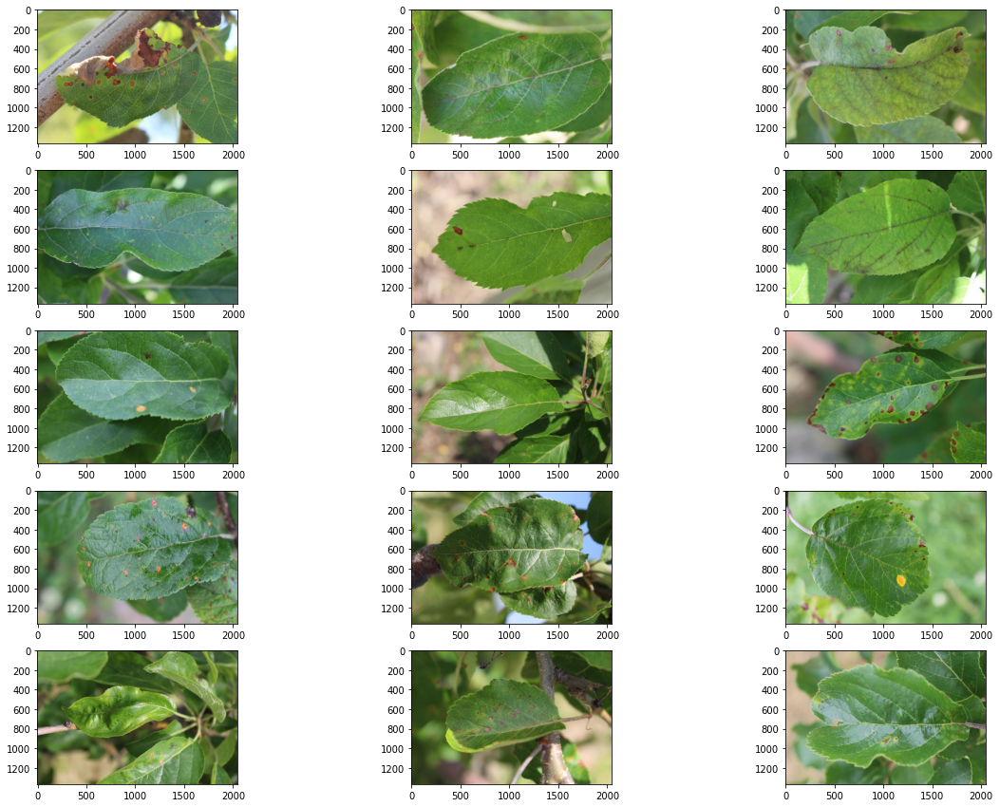

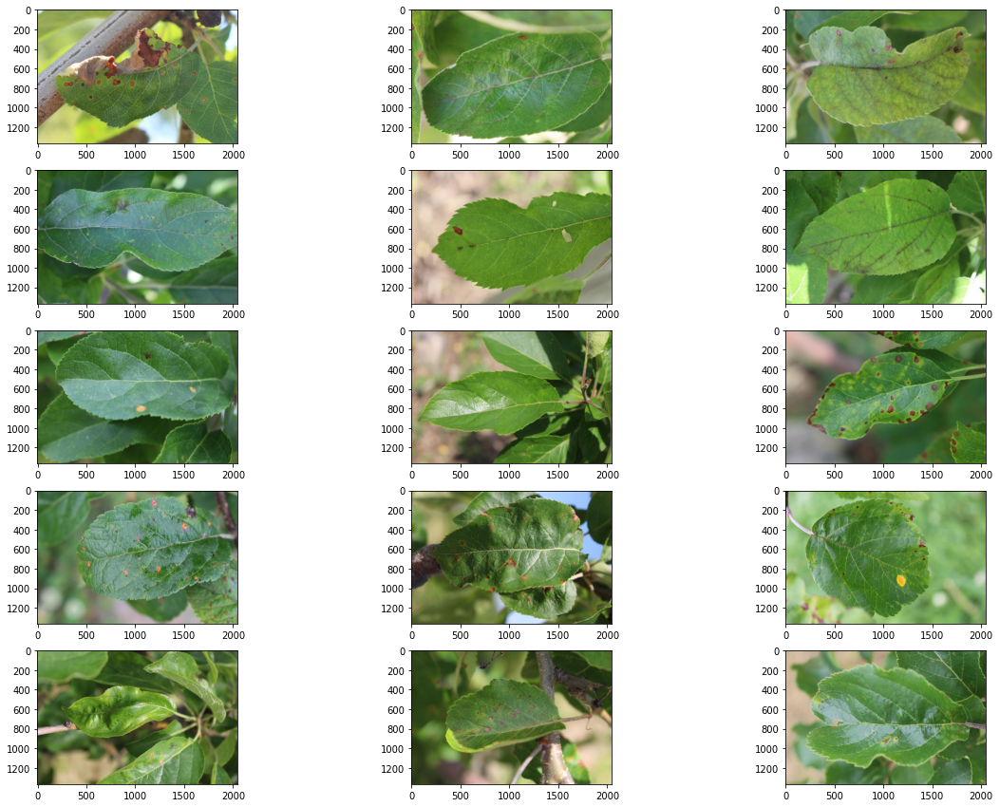

In [12]:
visualizeSample(cond_class=[0,1,0,0])

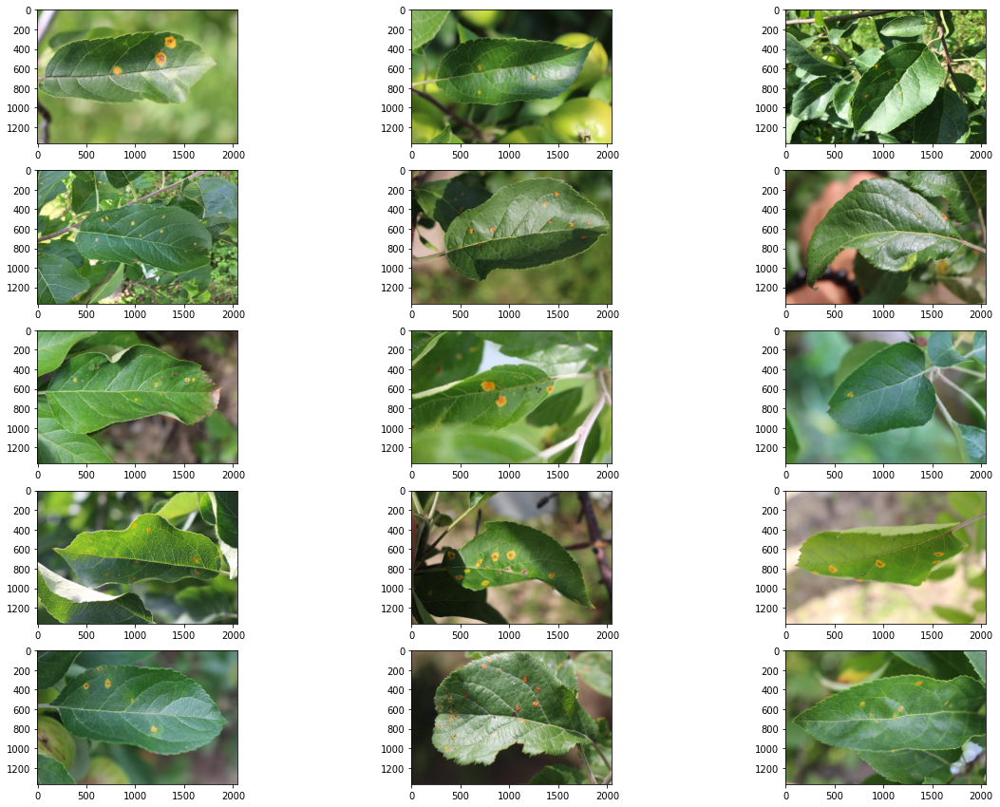

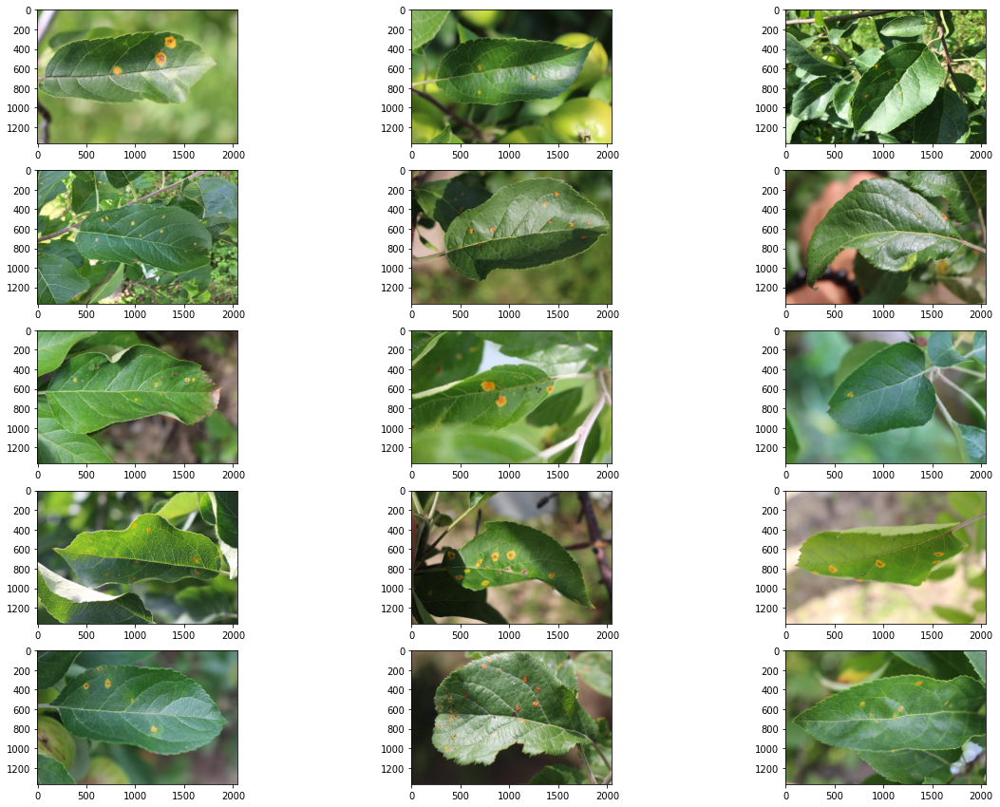

In [13]:
visualizeSample(cond_class=[0,0,1,0])

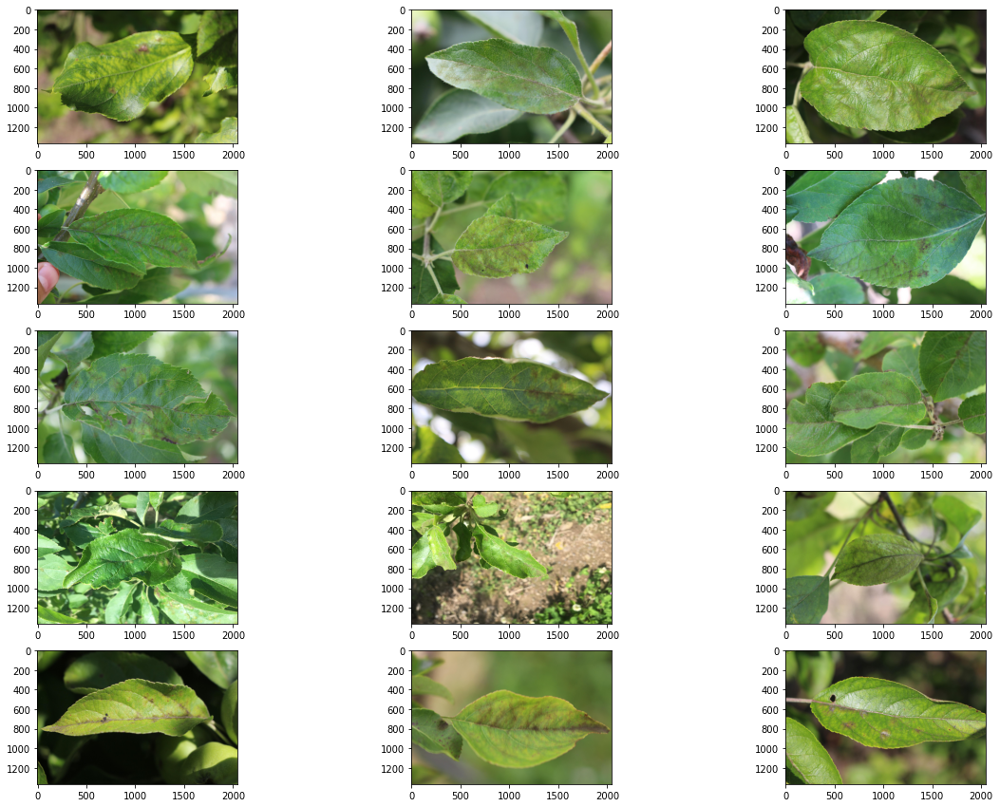

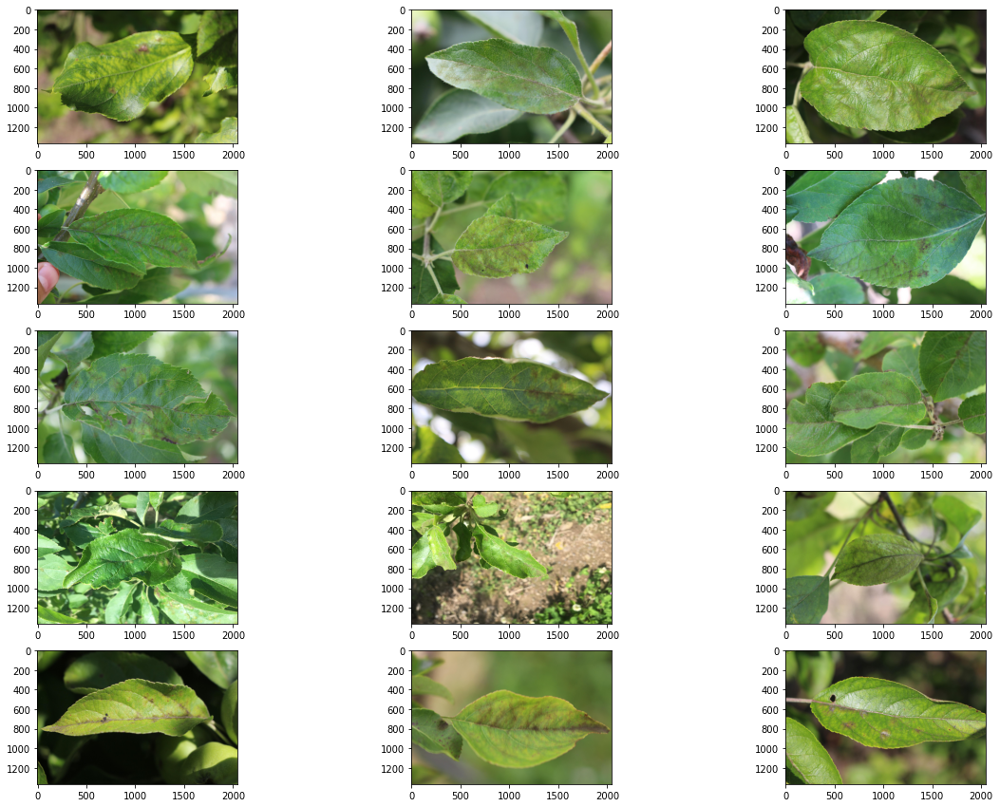

In [14]:
visualizeSample(cond_class=[0,0,0,1])

In [0]:
def blurImage(strPath):
    strPath = 'images/' + strPath + '.jpg'
    img = cv2.imread(strPath)
    img = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
    fig,ax = plt.subplots(1,2,figsize=(30,20))
    ax[0].imshow(img)
    ax[0].set_title("Original",fontsize=25)
    ax[1].imshow(cv2.blur(img,(50,50)))
    ax[1].set_title("Blurred",fontsize=25)
    plt.show()
def convImage(strPath):
    strPath = 'images/' + strPath + '.jpg'
    img = cv2.imread(strPath)
    img = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
    kernel = np.ones((7,7),np.float32)/25
    conv = cv2.filter2D(img,-1,kernel)
    fig,ax = plt.subplots(1,2,figsize=(30,20))
    ax[0].imshow(img)
    ax[0].set_title("Original",fontsize=25)
    ax[1].imshow(conv)
    ax[1].set_title("Convolved",fontsize=25)
    plt.show()
def invert(strPath):
    strPath = 'images/' + strPath + '.jpg'
    img = cv2.imread(strPath)
    img = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
    fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(30, 20))
    ax[0].imshow(img)
    ax[0].set_title('Original Image', fontsize=25)
    ax[1].imshow(cv2.flip(img, 0))
    ax[1].set_title('Vertical Flip', fontsize=25)
    ax[2].imshow(cv2.flip(img, 1))
    ax[2].set_title('Horizontal Flip', fontsize=25)
    plt.show()

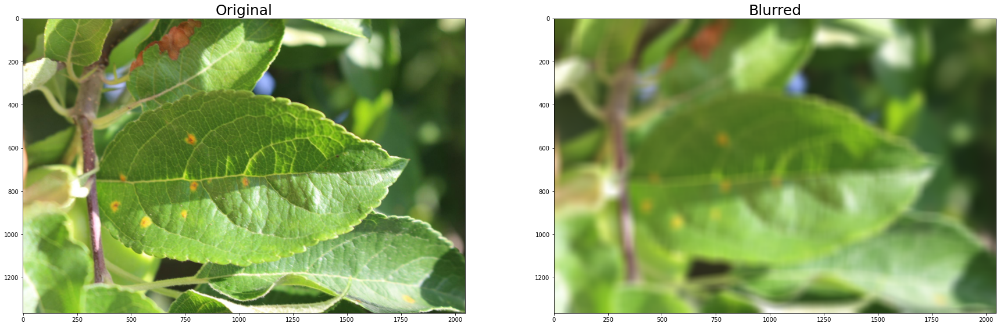

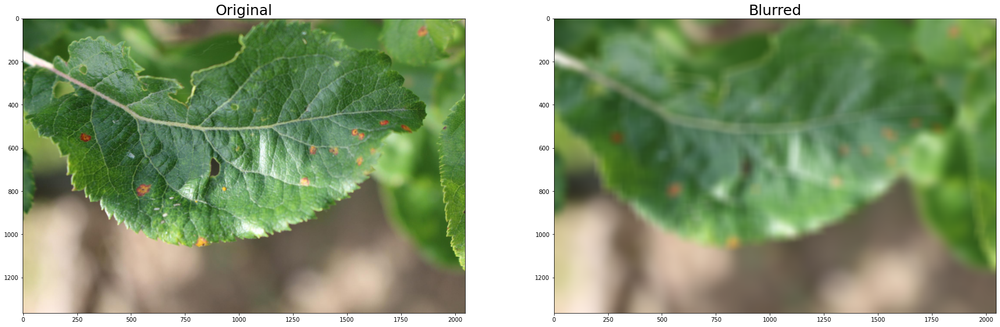

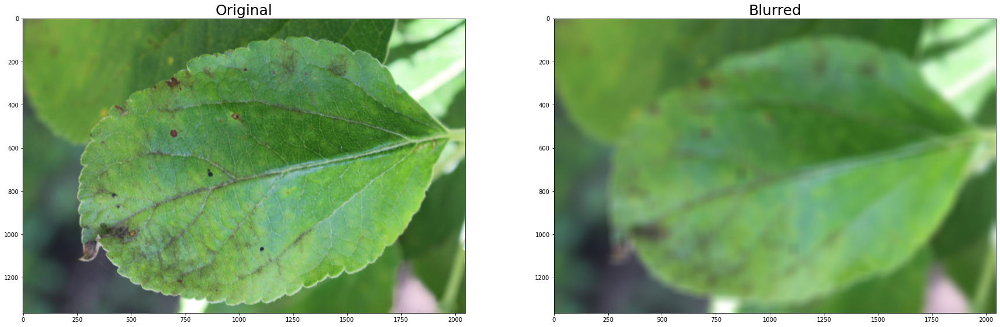

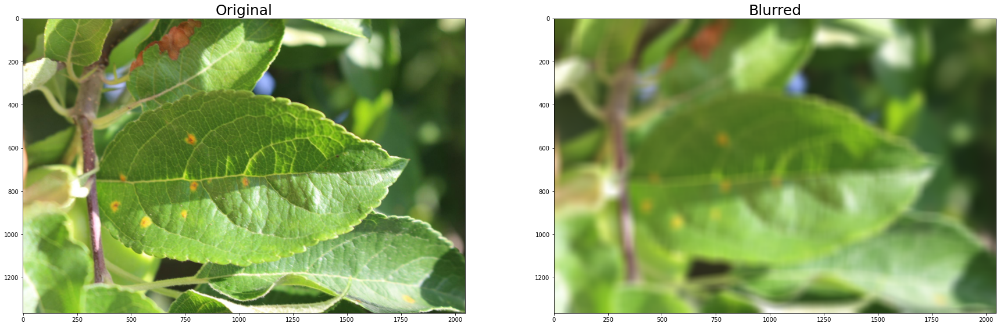

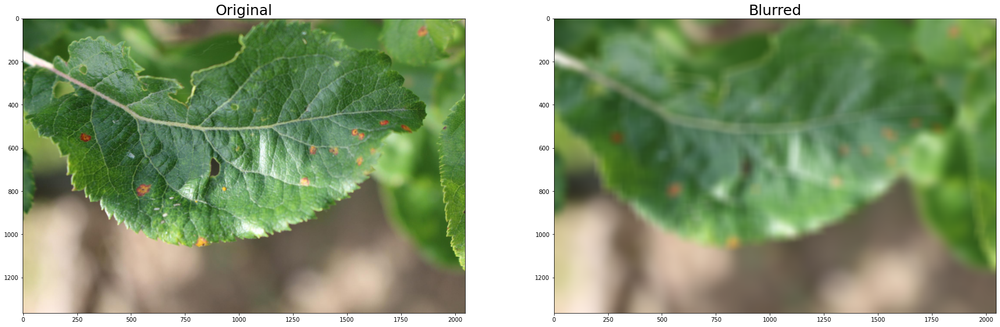

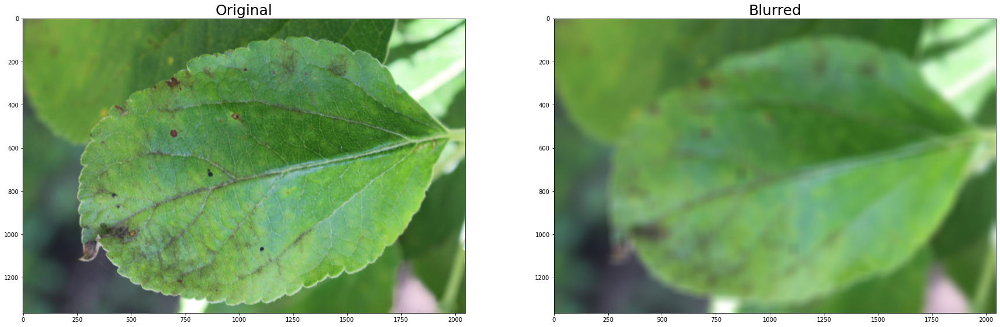

In [16]:
blurImage(train.loc[205,'image_id'])
blurImage(train.loc[1745,'image_id'])
blurImage(train.loc[250,'image_id'])

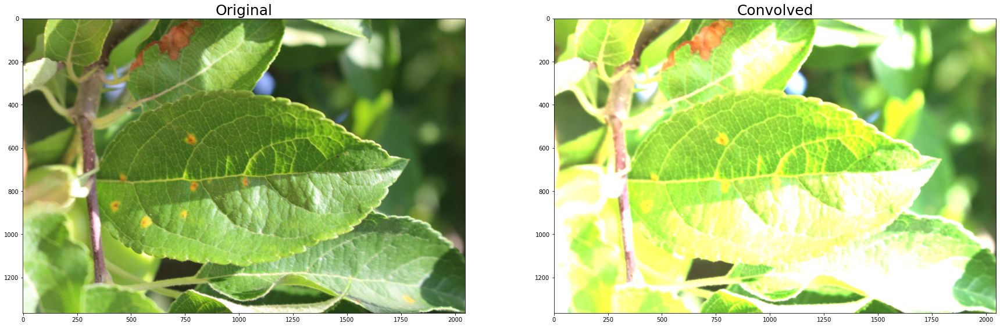

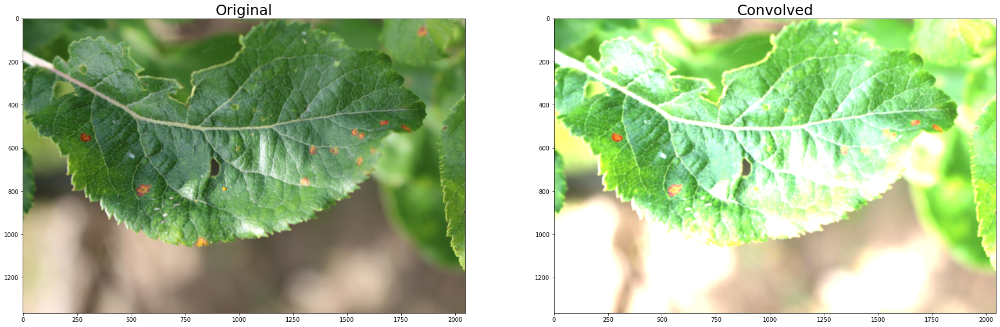

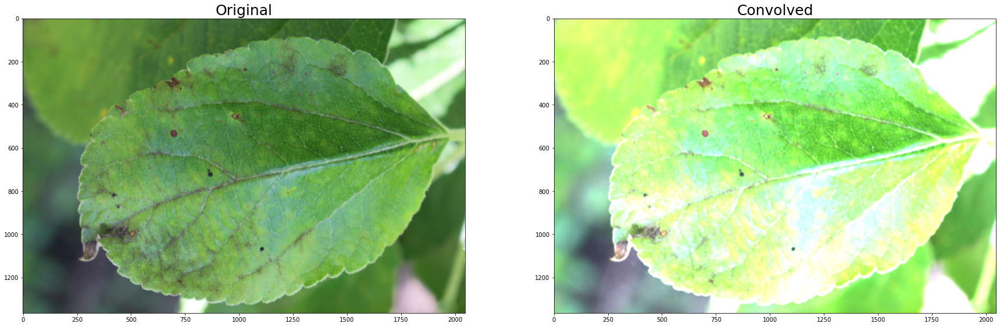

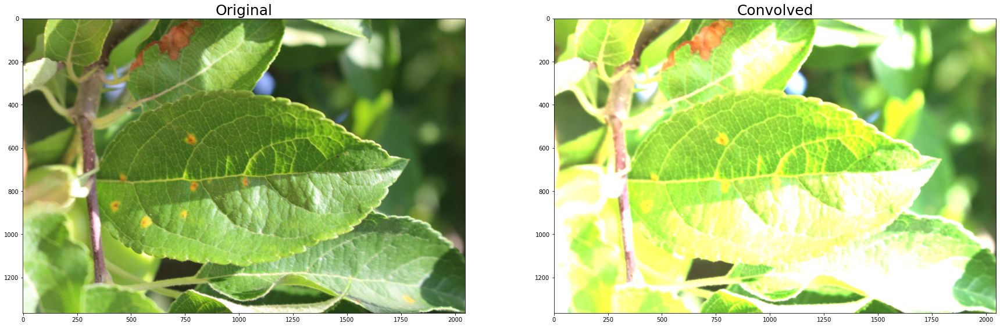

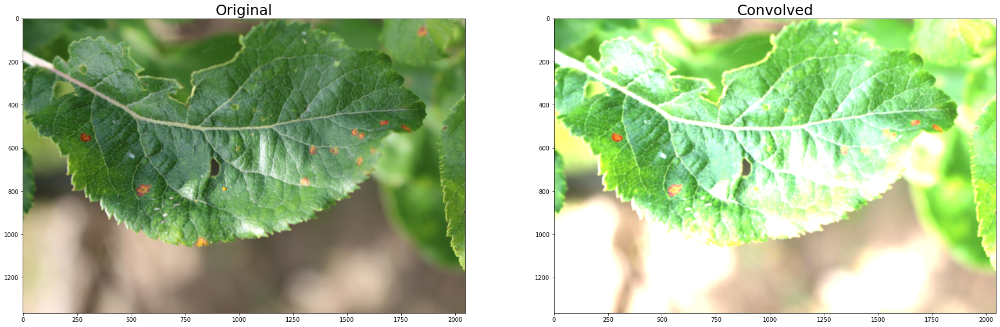

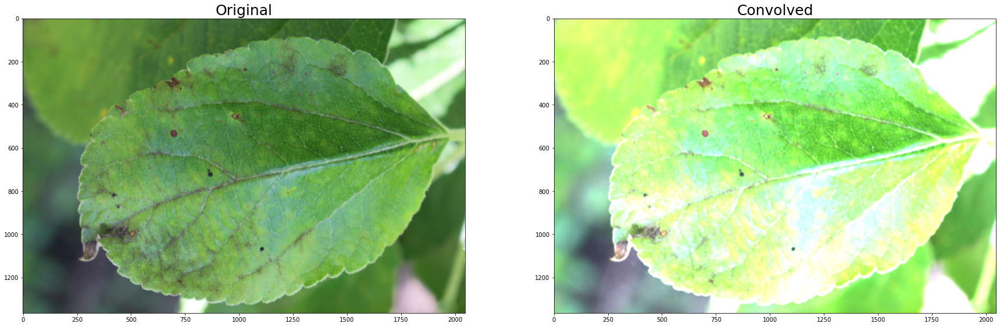

In [17]:
convImage(train.loc[205,'image_id'])
convImage(train.loc[1745,'image_id'])
convImage(train.loc[250,'image_id'])

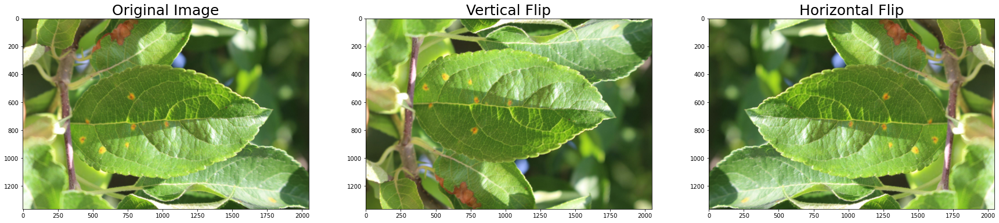

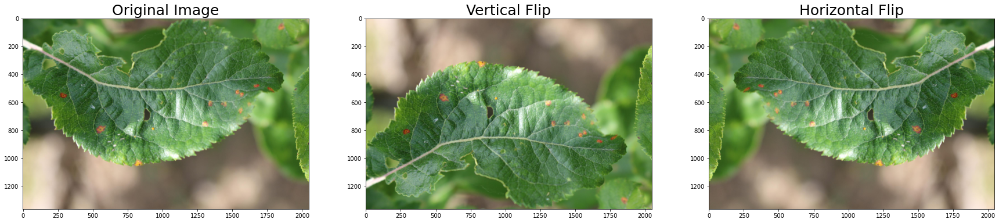

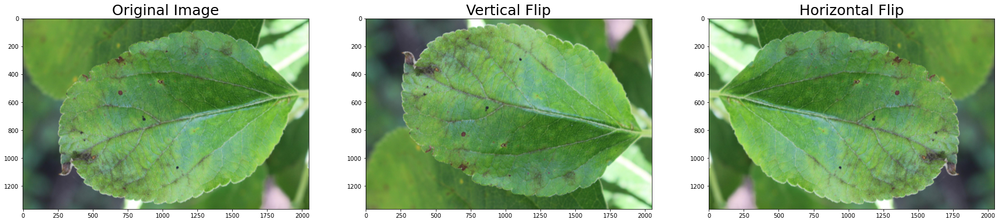

In [56]:
invert(train.loc[205,'image_id'])
invert(train.loc[1745,'image_id'])
invert(train.loc[250,'image_id'])

#Conv All Image

In [0]:
def convAllImage(x):
  strpath = 'images/' + x + '.jpg'
  savepath = 'conv/' + x + '.jpg'
  img = cv2.imread(strpath)
  img = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
  kernel = np.ones((5,5),np.float32)/25
  conv = cv2.filter2D(img,-1,kernel)
  cv2.imwrite(savepath,conv)
def blurAllImage(x):
  strpath = 'images/' + x +'.jpg'
  savepath = 'blurred/' + x + '.jpg'
  img = cv2.imread(strpath)
  img = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
  blur = cv2.blur(img,(100,100))
  cv2.imwrite(savepath,blur)

for x in tqdm(train.loc[:,'image_id']):
  convAllImage(x)
  blurAllImage(x)

for x in tqdm(test.loc[:,'image_id']):
  convAllImage(x)
  blurAllImage(x)

# Blurred All Image

In [0]:
img_size = 224

In [0]:
def make_model() :
    base = tf.keras.applications.vgg16.VGG16(include_top=False, weights='imagenet',input_shape=(img_size,img_size,3),pooling='avg')
    base.trainable = False  
    model = Sequential()
    model.add(base)
    """
    #Block 1
    model.add(Conv2D(64,kernel_size=(3,3),padding='same',activation='relu',input_shape=(img_size,img_size,3)))
    model.add(Conv2D(64,kernel_size=(3,3),padding='same',activation='relu'))
    model.add(Conv2D(64,kernel_size=(3,3),padding='same',activation='relu'))
    model.add(BatchNormalization())
    model.add(MaxPooling2D(pool_size=(2,2)))
    model.add(Dropout(0.3))
    #Block 2
    model.add(Conv2D(128,kernel_size=(3,3),padding='same',activation='relu'))
    model.add(Conv2D(128,kernel_size=(3,3),padding='same',activation='relu'))
    model.add(Conv2D(128,kernel_size=(3,3),padding='same',activation='relu'))
    model.add(BatchNormalization())
    model.add(MaxPooling2D(pool_size=(2,2)))
    model.add(Dropout(0.3))
    #Block 3
    model.add(Conv2D(256,kernel_size=(3,3),padding='same',activation='relu'))
    model.add(Conv2D(256,kernel_size=(3,3),padding='same',activation='relu'))
    model.add(Conv2D(256,kernel_size=(3,3),padding='same',activation='relu'))
    model.add(BatchNormalization())
    model.add(MaxPooling2D(pool_size=(2,2)))
    model.add(Dropout(0.2))
    #Block 4 
    model.add(Conv2D(512,kernel_size=(3,3),padding='same',activation='relu'))
    model.add(Conv2D(512,kernel_size=(3,3),padding='same',activation='relu'))
    model.add(Conv2D(512,kernel_size=(3,3),padding='same',activation='relu'))
    model.add(BatchNormalization())
    model.add(MaxPooling2D(pool_size=(2,2)))
    model.add(Dropout(0.2))    
    #Block 5
    model.add(Conv2D(1024,kernel_size=(3,3),padding='same',activation='relu'))
    model.add(Conv2D(1024,kernel_size=(3,3),padding='same',activation='relu'))
    model.add(BatchNormalization())
    model.add(MaxPooling2D(pool_size=(2,2)))
    model.add(Dropout(0.2))
    """
    #Final Block
    model.add(Flatten())
    model.add(Dense(512,activation='relu'))
    model.add(Dropout(0.3))
    model.add(Dense(256,activation='relu'))
    model.add(Dense(128,activation='relu'))
    model.add(Dense(32,activation='relu'))
    model.add(Dense(4,activation='softmax'))
    #Compile
    model.compile(optimizer='adam',loss = 'categorical_crossentropy',metrics = ['accuracy'])
    #model.fit(X,y,validation_split=0.1,batch_size=batch_size,epochs=epochs)
    
    return model  

In [0]:
train.head()

In [0]:
train.loc[:,'healthy':]

In [0]:
reduce_lr =  ReduceLROnPlateau(monitor = "val_loss", factor = 0.5, patience = 10,
  verbose = 0, mode = "auto", epsilon = 1e-04, cooldown = 0,
  min_lr = 1e-5)
es = EarlyStopping(monitor = "val_loss" , verbose = 1 , mode = 'min' , patience = 50 )
mc = ModelCheckpoint('best_model.h5', monitor = 'val_accuracy' , mode = 'max', verbose = 1 , save_best_only = True)

In [0]:
global_hist = []
EPOCH = 40
def trainAndPred(dir_path):
  #Load entire Data
  train_images = []
  test_images = []
  for x in tqdm(train.loc[:,'image_id']):
    im = cv2.imread(dir_path + "/" + x +".jpg")
    im = cv2.cvtColor(im,cv2.COLOR_BGR2RGB)
    im = cv2.resize(im,(img_size,img_size))
    im = im.astype('float32')
    train_images.append(im)
  for x in tqdm(test.loc[:,'image_id']):
    im = cv2.imread(dir_path + "/" + x +".jpg")
    im = cv2.cvtColor(im,cv2.COLOR_BGR2RGB)
    im = cv2.resize(im,(img_size,img_size))
    im = im.astype('float32')
    test_images.append(im)

  #Into Numpy array
  X = np.ndarray(shape=(len(train_images),img_size,img_size,3),dtype=np.float32)
  for i,image in enumerate(train_images) :
    X[i] = image
  X = X/255.0    
  del(train_images)
  y = np.array(train.loc[:,'healthy':].values)
  X_test = np.ndarray(shape=(len(test_images),img_size,img_size,3),dtype=np.float32)
  for i,image in enumerate(test_images) :
    X_test[i] = image
  X_test = X_test/255.0    
  del(test_images)

  #TTS
  X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.15, random_state=42)

  #DataGenerator
  data_gen = ImageDataGenerator(rotation_range=45,
                              horizontal_flip=True,
                              vertical_flip=True,
                              width_shift_range=0.2,
                              height_shift_range=0.2,
                              zoom_range = 0.1,
                              shear_range = 0.1,
                              #brightness_range = [0.5,1.5],
                              fill_mode = 'nearest')
  data_gen.fit(X)
  del(X)
  #Model
  model = make_model()
  model.summary()
  history = model.fit_generator(data_gen.flow(X_train,y_train,batch_size=32),
                    steps_per_epoch = 200,
                    epochs = EPOCH,
                    verbose = True,
                    validation_data= (X_val,y_val),
                    callbacks=[reduce_lr,es,mc]
                   )
  global_hist.append(history)
  #Predictions
  pred = model.predict(X_test)
  sub.loc[:,'healthy':] = pred
  savepath = "submission_{}.csv".format(dir_path)
  sub.to_csv(savepath,index=False)

In [26]:
trainAndPred("images")
trainAndPred("blurred")
trainAndPred("conv")

200/200 [==============================] - ETA: 0s - loss: 0.5769 - accuracy: 0.7829
Epoch 00022: val_accuracy did not improve from 0.77007
200/200 [==============================] - 76s 381ms/step - loss: 0.5769 - accuracy: 0.7829 - val_loss: 0.6419 - val_accuracy: 0.7372 - lr: 0.0010

Epoch 00022: val_accuracy did not improve from 0.77007
200/200 [==============================] - 76s 381ms/step - loss: 0.5769 - accuracy: 0.7829 - val_loss: 0.6419 - val_accuracy: 0.7372 - lr: 0.0010
Epoch 23/40
Epoch 23/40
200/200 [==============================] - ETA: 0s - loss: 0.5605 - accuracy: 0.7836
Epoch 00023: val_accuracy did not improve from 0.77007
200/200 [==============================] - 77s 386ms/step - loss: 0.5605 - accuracy: 0.7836 - val_loss: 0.6410 - val_accuracy: 0.7336 - lr: 0.0010

Epoch 00023: val_accuracy did not improve from 0.77007
200/200 [==============================] - 77s 386ms/step - loss: 0.5605 - accuracy: 0.7836 - val_loss: 0.6410 - val_accuracy: 0.7336 - lr: 0.0

In [27]:
!ls

best_model.h5  plant-pathology-2020-fgvc7.zip  submission_conv.csv
blurred        sample_data		       submission_images.csv
conv	       sample_submission.csv	       test.csv
images	       submission_blurred.csv	       train.csv
best_model.h5  plant-pathology-2020-fgvc7.zip  submission_conv.csv
blurred        sample_data		       submission_images.csv
conv	       sample_submission.csv	       test.csv
images	       submission_blurred.csv	       train.csv


In [28]:
!kaggle competitions submit -c plant-pathology-2020-fgvc7 -f submission_conv.csv -m "Conv VGG"
!kaggle competitions submit -c plant-pathology-2020-fgvc7 -f submission_blurred.csv -m "Blurred VGG"
!kaggle competitions submit -c plant-pathology-2020-fgvc7 -f submission_images.csv -m "Images VGG"

100% 161k/161k [00:03<00:00, 46.8kB/s]
100% 161k/161k [00:03<00:00, 46.8kB/s]
100% 157k/157k [00:03<00:00, 45.9kB/s]
100% 157k/157k [00:03<00:00, 45.9kB/s]
100% 160k/160k [00:03<00:00, 46.4kB/s]
100% 160k/160k [00:03<00:00, 46.4kB/s]
Successfully submitted to Plant Pathology 2020 - FGVC7

In [32]:
!kaggle competitions submit -c plant-pathology-2020-fgvc7 -f submission_blurred.csv -m "Blurred VGG"

100% 157k/157k [00:03<00:00, 45.7kB/s]
Successfully submitted to Plant Pathology 2020 - FGVC7

In [42]:
!kaggle competitions submit -c plant-pathology-2020-fgvc7 -f submission_images.csv -m "Images VGG"

100% 160k/160k [00:03<00:00, 46.5kB/s]
Successfully submitted to Plant Pathology 2020 - FGVC7

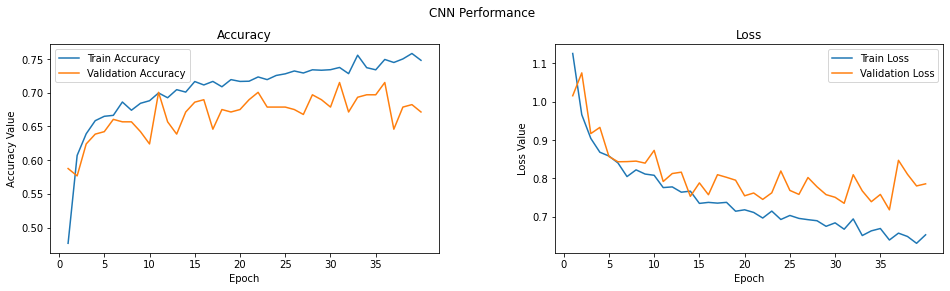

<Figure size 432x288 with 0 Axes>

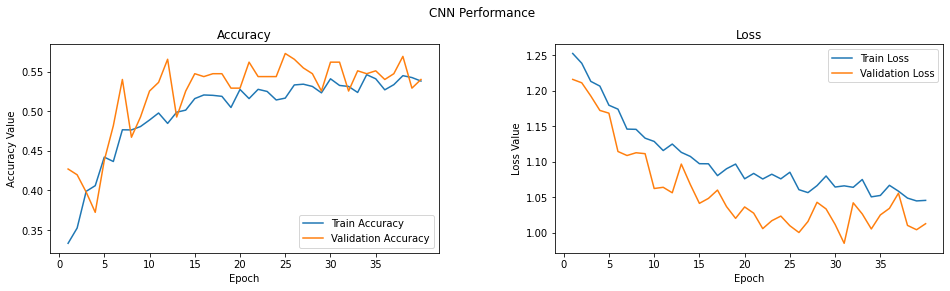

<Figure size 432x288 with 0 Axes>

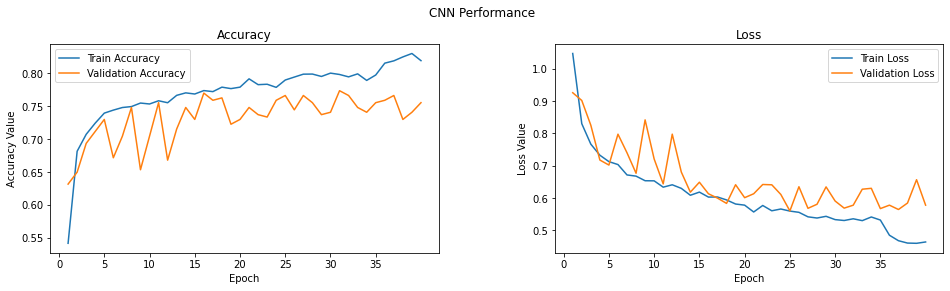

<Figure size 432x288 with 0 Axes>

In [55]:
def plot_performance(title,history) :
    f, (ax1, ax2) = plt.subplots(1, 2,figsize=(16,4))
    t = f.suptitle('CNN Performance', fontsize=12)
    f.subplots_adjust(top=0.85, wspace=0.3)
    epoch_list = list(range(1,EPOCH+1))
    ax1.plot(epoch_list, history.history['accuracy'], label='Train Accuracy')
    ax1.plot(epoch_list, history.history['val_accuracy'], label='Validation Accuracy')
    ax1.set_xticks(np.arange(0, EPOCH, 5))
    ax1.set_ylabel('Accuracy Value')
    ax1.set_xlabel('Epoch')
    ax1.set_title('Accuracy')
    l1 = ax1.legend(loc="best")

    ax2.plot(epoch_list, history.history['loss'], label='Train Loss')
    ax2.plot(epoch_list, history.history['val_loss'], label='Validation Loss')
    ax2.set_xticks(np.arange(0, EPOCH, 5))
    ax2.set_ylabel('Loss Value')
    ax2.set_xlabel('Epoch')
    ax2.set_title('Loss')
    l2 = ax2.legend(loc="best")
    plt.show()
    plt.savefig("{}.png".format(title))

for (i,h) in enumerate(global_hist):
  if i==0:
    plot_performance("images",h)
  elif i==1:
    plot_performance("blur",h)
  else:
    plot_performance("conv",h)